<a href="https://colab.research.google.com/github/delerus/DAT300/blob/master/case.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importere nødvendinge bibliotek

In [0]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np
import missingno as msno
import plotly.express as px
from datetime import datetime
import seaborn as sns

# Laste inn dataen

In [0]:
url = 'https://storage.googleapis.com/nrk-us/intervjuoppgave/unge-lovende.csv'
df = pd.read_csv(url)

# Få oversikt over dataen (Summary)

In [55]:
df.head()

,userId,programId,visitStartTime,timeWithinVisit
0,2172883450372358834,KMTE20000514,1447617021,1614261
1,2214426530139075244,KMTE20000314,1447578419,1782834
2,3261020776373483236,KMTE20000114,1447180923,206935
3,3300130967635711526,KMTE20000114,1447139006,1630400
4,3303148955234989541,KMTE20000614,1447186150,4274932


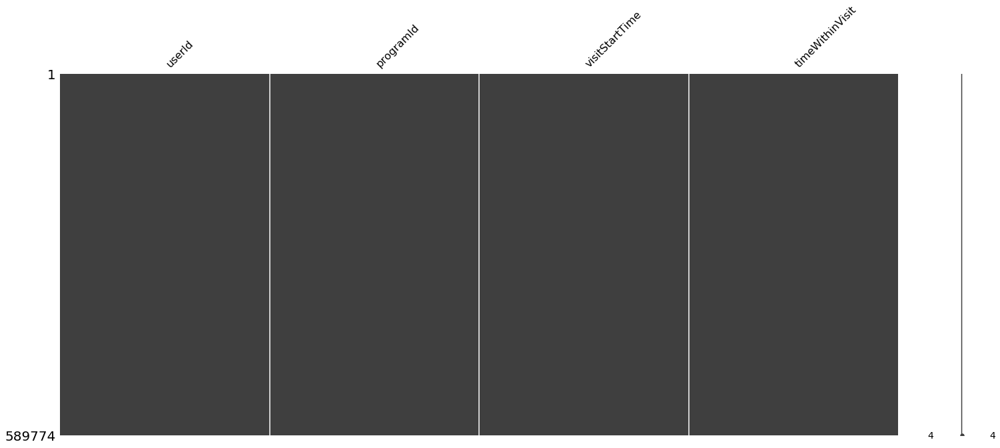

In [56]:
msno.matrix(df) #Sjekker om det mangler noe data. Det gjør det ikke

In [57]:
sum(df.duplicated()) #Leter etter duplikater i datasettet

5

In [58]:
df = df.drop_duplicates()
len(df) # De 5 duplikatene er fjernet.

589769

In [59]:
df.describe() #Statistikk

,userId,visitStartTime,timeWithinVisit
count,5.897690e+05,5.897690e+05,5.897690e+05
mean,4.611299e+18,1.447792e+09,3.327027e+06
std,2.659288e+18,7.009111e+05,2.749910e+06
min,3.549506e+13,1.446807e+09,0.000000e+00
25%,2.308258e+18,1.447185e+09,1.616245e+06
50%,4.610796e+18,1.447678e+09,2.387917e+06
75%,6.909517e+18,1.448225e+09,4.568217e+06
max,9.223349e+18,1.450577e+09,3.258846e+07


minste verdien for timeWithinVisit er 0ms

In [60]:
fig = px.box(df, y="visitStartTime")
fig.show()

In [61]:
sum(df.timeWithinVisit < 1e3) # Hvor mange har sett under 1 sekund? 

30322

In [83]:
print(len(df))
df = df[df.timeWithinVisit >= 1e3] # Tar vekk alle som har sett under 1 sekund.
print(len(df))

559447
559447


In [63]:
df.describe() #Statistikk

,userId,visitStartTime,timeWithinVisit
count,5.594470e+05,5.594470e+05,5.594470e+05
mean,4.610902e+18,1.447791e+09,3.507351e+06
std,2.659239e+18,7.006519e+05,2.709133e+06
min,3.549506e+13,1.446807e+09,1.026000e+03
25%,2.307990e+18,1.447185e+09,1.635343e+06
50%,4.610775e+18,1.447676e+09,2.553201e+06
75%,6.908335e+18,1.448224e+09,4.865654e+06
max,9.223349e+18,1.450577e+09,3.258846e+07


In [23]:
import plotly.express as px
fig = px.histogram(df, x="timeWithinVisit")
fig.show()

In [8]:
df.groupby('userId').head()

,userId,programId,visitStartTime,timeWithinVisit
0,2172883450372358834,KMTE20000514,1447617021,1614261
1,2214426530139075244,KMTE20000314,1447578419,1782834
2,3261020776373483236,KMTE20000114,1447180923,206935
3,3300130967635711526,KMTE20000114,1447139006,1630400
4,3303148955234989541,KMTE20000614,1447186150,4274932
...,...,...,...,...
589764,5704978818464145377,KMTE20000314,1447610532,522206
589765,5834385444353126920,KMTE20000514,1447626539,1578182
589767,5872695173947484707,KMTE20000114,1447546954,2676677
589768,5896983029269891017,KMTE20000114,1447617759,714362


# Legge til kolonner

In [0]:
def episode_konverterer(val):
  return int(val[-3])

df['episodeNr'] = df.programId.apply(episode_konverterer)

In [0]:
def tid_konverterer(time):
  return(datetime.utcfromtimestamp(time).strftime('%Y-%m-%d %H:%M:%S'))

df["utcVisitStartTime"] = df.visitStartTime.apply(tid_konverterer)

In [79]:
print(df.utcVisitStartTime.max())
print(df.utcVisitStartTime.min())

2015-12-20 02:11:21
2015-11-06 10:43:16


In [85]:
df.head()

,userId,programId,visitStartTime,timeWithinVisit,episodeNr,utcVisitStartTime
0,2172883450372358834,KMTE20000514,1447617021,1614261,5,2015-11-15 19:50:21
1,2214426530139075244,KMTE20000314,1447578419,1782834,3,2015-11-15 09:06:59
2,3261020776373483236,KMTE20000114,1447180923,206935,1,2015-11-10 18:42:03
3,3300130967635711526,KMTE20000114,1447139006,1630400,1,2015-11-10 07:03:26
4,3303148955234989541,KMTE20000614,1447186150,4274932,6,2015-11-10 20:09:10


# Lager ny dataframe med kun første episode sett av hver bruker

In [0]:
df2 = df.sort_values(by=['userId', 'programId','episodeNr'])
df2 = df2.drop_duplicates(subset = ["userId","episodeNr"], keep="first")

,userId,programId,visitStartTime,timeWithinVisit,episodeNr,utcVisitStartTime
379248,35495059173323,KMTE20000114,1449439176,1667325,1,2015-12-06 21:59:36
77970,35495059173323,KMTE20000214,1449591658,1621509,2,2015-12-08 16:20:58
27553,35495059173323,KMTE20000314,1449591658,3368584,3,2015-12-08 16:20:58
259966,35495059173323,KMTE20000414,1449612323,926052,4,2015-12-08 22:05:23
449353,35495059173323,KMTE20000514,1449612323,2664110,5,2015-12-08 22:05:23
...,...,...,...,...,...,...
360717,9223348729506738378,KMTE20000214,1447777336,3439437,2,2015-11-17 16:22:16
429251,9223348729506738378,KMTE20000314,1447803466,3452865,3,2015-11-17 23:37:46
225192,9223348729506738378,KMTE20000414,1447819718,1613517,4,2015-11-18 04:08:38
560136,9223348729506738378,KMTE20000514,1447924125,1571177,5,2015-11-19 09:08:45


# Oppgave 1 Nøkkeltall

Hvilke nøkkeltall?
* Hvor mange har sett på det over tid? (Over hvor lang tid)?
* 

episode | Antal visninger | Unike seere | "Review value"
--- | --- | --- | --- 
1 | Row 1, Col 2 | Row 1, Col 3 | Row 1, Col 4
2 | Row 2, Col 2 | Row21, Col 3 | Row 2, Col 4
3 | Row 3, Col 2 | Row31, Col 3 | Row 3, Col 4
4 | Row 4, Col 2 | Row41, Col 3 | Row 4, Col 4
5 | Row 5, Col 2 | Row51, Col 3 | Row 5, Col 4
6 | Row 6, Col 2 | Row61, Col 3 | Row 6, Col 4
total | Row 6, Col 2 | Row61, Col 3 | Row 6, Col 4



In [0]:
nokkeltall_df = pd.DataFrame(index = [1,2,3,4,5,6,"total"])

## Antall visninger

In [0]:
antall_visninger = []
antall_visninger = [sum(df.episodeNr == n) for n in range(1,7)]
antall_visninger.append(sum(antall_visninger))

nokkeltall_df["Antall visninger"] = antall_visninger

In [205]:
nokkeltall_df

,Antall visninger
1,111558
2,94717
3,89596
4,87965
5,87666
6,87945
total,559447


## Unike visninger

In [0]:
df_unike = df.sort_values(by=['userId', 'programId','episodeNr'])
df_unike = df_unike.drop_duplicates(subset = ["userId","episodeNr"], keep="first")

In [0]:
unike_visninger = []
unike_visninger = [sum(df_unike.episodeNr == n) for n in range(1,7)]
unike_visninger.append(sum(unike_visninger))

nokkeltall_df["Unike visninger"] = unike_visninger

In [208]:
nokkeltall_df

,Antall visninger,Unike visninger
1,111558,106380
2,94717,90480
3,89596,86006
4,87965,84576
5,87666,83602
6,87945,83732
total,559447,534776


## Review Value

In [0]:
nokkeltall_df["Review value"] = (nokkeltall_df["Antall visninger"] - nokkeltall_df["Unike visninger"])/ nokkeltall_df["Unike visninger"] *100

In [210]:
nokkeltall_df

,Antall visninger,Unike visninger,Review value
1,111558,106380,4.867456
2,94717,90480,4.682803
3,89596,86006,4.174127
4,87965,84576,4.007047
5,87666,83602,4.861128
6,87945,83732,5.031529
total,559447,534776,4.613333


In [211]:
s = nokkeltall_df[:6].style.background_gradient(cmap="YlGnBu")
s

,Antall visninger,Unike visninger,Review value
1,111558,106380,4.86746
2,94717,90480,4.6828
3,89596,86006,4.17413
4,87965,84576,4.00705
5,87666,83602,4.86113
6,87945,83732,5.03153


# Oppgave 2 Hva kan vi si om bingewatching?



In [194]:
px.histogram(df_unike,x="timeWithinVisit")

In [201]:
sum(df.utcVisitStartTime < '2015-11-13 10:43:16')

201504

In [212]:
px.histogram(df_unike,x="utcVisitStartTime",nbins=44)

In [215]:
df.utcVisitStartTime.min()

'2015-11-06 10:43:16'

In [221]:
px.histogram(df[df["utcVisitStartTime"] < '2015-11-07 10:43:16'],x="timeWithinVisit")

In [218]:
px.histogram(df_unike[df_unike["utcVisitStartTime"] > '2015-12-1 10:43:16'],x="timeWithinVisit")

In [220]:
0.6e6 / 60e3

10.0

In [0]:
px.histogram(data_frame=heroes[~heroes.Gender.isna()]
             , x="Strength"
             , color='Gender'
             , barmode = 'group'
             , labels={'count':'Count of Heroes'}
             , title="Strength Distribution : Count of Heroes"
             , template='plotly'
            )